# Overview


Here we make a GIF to show the predicted accessibility profiles in *in silico* marignalization, capturing
dynamics as motifs are inserted at different distances.

We try a few example with hard or soft motif synergy to understand their effects/dynamics
as we move motifs closer together.

_Run on durga_

# Setup

In [2]:
%load_ext autoreload
%autoreload 2

# deal with matplotlib plots
%matplotlib inline

# display all outputs in a cell
get_ipython().ast_node_interactivity = 'all'

from IPython.display import display, HTML

In [ ]:
# misc
import sys
import os
import numpy as np
import random
from tqdm import tqdm
import pandas as pd
import base64


# io
import h5py
from pyfaidx import Fasta

import pickle

import pyranges as pr
import torch

# plotting
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn; seaborn.set_style('white')
import matplotlib.ticker as ticker
import plotnine as pn
import logomaker
import tangermeme
from tangermeme.plot import plot_logo
from tangermeme.utils import reverse_complement
import matplotlib.animation as animation


print(np.__version__)
print(tangermeme.__version__)

sys.path.append("/users/sjessa/projects/HDMA-internal/Figures/chrombpnet/")
import tangermeme_utils as tanutils
from tangermeme_utils.utils import plot_motif
from tangermeme_utils.eval import summarize_across_folds, mean_across_sequences

# editable text in PDFs
# https://stackoverflow.com/a/54111532
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

2.0.2
0.4.3


# Variables

In [4]:
INPUTLEN = 2114
OUTPUTLEN = 1000
SHIFT_REL_INPUT = np.int64((2114 - 1000) / 2)
SHIFT_REL_INPUT

NARROWPEAK_SCHEMA = ["chr", "start", "end", "1", "2", "3", "4", "5", "6", "summit"]

LOGO_ALPHABET = 'ACGT'

# finemo colorscheme
LOGO_COLORS = {"A": '#109648', "C": '#255C99', "G": '#F7B32B', "T": '#D62839'}

# logomaker colorscheme
LOGO_COLORS2= {
        'G': [1, .65, 0],
        'T': [1, 0, 0],
        'C': [0, 0, 1],
        'A': [0, .5, 0]
    }

CHAR_IGNORE = ['QWERYUIOPSDFHJKLZXVBNM']

np.int64(557)

# Paths

In [5]:
with open("../../DURGA_DIRS.txt", 'r') as f:
	proj_in = f.readline().strip()
	proj_out = f.readline().strip()
	proj_out = os.path.join(proj_out, "03-chrombpnet")
	fig_out = f.readline().strip()
	fig_out = os.path.join(fig_out, "03-chrombpnet/03-syntax/04d")

with open("../../AK_PROJ_DIR.txt", 'r') as f:
	kundaje_dir = f.readline().strip()

ism_path = os.path.join(proj_out, "03-syntax/04b/in_silico_marginalization/")

# output paths
os.makedirs(fig_out, exist_ok=True)

# Helper functions

In [6]:
def create_animation(motif_name, y_before_profile_means, y_after_profile_means, input_motifs, best_orientation, output_path,
					 best_spacing, pos_range=range(250, 750), fps=10, reverse=False):
	"""
	Creates the animation given the summarized profile data, adapted for PyTorch,
	with options for plotting in reverse, setting figure size, "ghost" profile, and motif position blocks.

	Args:
		motif_name: Motif name
		y_before_profile_means (torch.Tensor):  Mean profile background
		y_after_profile_means (torch.Tensor):   Mean profile edited
		input_motifs (dict): Dictionary of motifs, keyed by orientation.
		best_orientation (str): Best orientation to use for the graph title.
		output_path (str): Path to save the animation (GIF).
		best_spacing (int): Best spacing index for optimal profile.
		pos_range (range): Range of indices to plot.
		fps (int): Frames per second.
		reverse (bool): If True, plot the spacings in reverse order. Default is False.
	"""

	seqA = input_motifs[best_orientation][0]
	seqB = input_motifs[best_orientation][1]
	len_seqA = len(seqA)
	len_seqB = len(seqB)

	num_spacings = len(y_after_profile_means)
	
	# Ensure y_before_profile_means and y_after_profile_means are on CPU
	y_before_profile_means = y_before_profile_means.cpu()
	y_after_profile_means = y_after_profile_means.cpu()
	print(y_after_profile_means.shape)

	y_max = torch.max(torch.stack([torch.max(y_after_profile_means), torch.max(y_before_profile_means), torch.tensor(0.5)])).item()  # Convert to scalar
	y_min = torch.min(torch.stack([torch.min(y_after_profile_means), torch.min(y_before_profile_means)])).item() # Convert to scalar
	print(y_max)
	print(y_min)

	fig, ax = plt.subplots(figsize=(9, 5))
	ax.set_xlim(pos_range.start - 250, pos_range.stop - 250)  # correct
	ax.set_ylim(y_min, y_max)  # Use scalar y_min and y_max
	ax.set_xlabel("Position relative to insertion (bp)")
	ax.set_ylabel("Avg. predicted profile")
	ax.set_title(f"{motif_name}")

	line_before, = ax.plot([], [], label="background", color="black", alpha=0.4, lw=2)
	line_after, = ax.plot([], [], label="joint effect", color="red", alpha=0.8, lw=2)
	best_line, = ax.plot([], [], label="joint @ optimal syntax", color="red", alpha=0.3, lw=2) 
	ax.legend()
	spacing_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

	# Initial positions (out of frame)
	motif_a = ax.fill_between([], [y_min], [y_max], color='yellow', alpha=0.3) #correct way
	motif_b = ax.fill_between([], [y_min], [y_max], color='yellow', alpha=0.3) #correct way

	def init():
		line_before.set_data([], [])
		line_after.set_data([], [])
		best_line.set_data([], [])
		spacing_text.set_text('')
		return line_before, line_after, best_line, spacing_text, motif_a, motif_b

	def animate(i):
		num_spacings_to_loop = 100  # Number of spacings you want to loop through
		offset = 100  # Offset to start from the last 100 spacings (200 - 100)
		# hold_frames = 10  # The number of frames to hold at the best spacing

		# Local best spacing!
		# best_spacing_local = best_spacing - offset

		# Calculate the effective frame to account for hold frames
		effective_frame = i % (num_spacings_to_loop)

		# Handle best spacing holding:
		if reverse:
			spacing = 200 - 1 - ((effective_frame % num_spacings_to_loop) + offset)
		else:
			spacing = (effective_frame % num_spacings_to_loop) + offset

		print(f"Effective Frame: {effective_frame}, Spacing: {spacing}") #check

		x = np.arange(len(y_after_profile_means[spacing].T[pos_range]))

		# Ensure correct type and that we move the data to the CPU before converting to numpy
		y_before_data = y_before_profile_means[spacing].T[pos_range].cpu().numpy()
		y_after_data = y_after_profile_means[spacing].T[pos_range].cpu().numpy()

		# print(f"Frame: {i}, Spacing: {spacing}") #added
		# print(f"x shape: {x.shape}") #added
		# print(f"y_ind_data shape: {y_ind_data_reshaped.shape}") #added
		# print(f"y_joint_data shape: {y_joint_data.shape}") #added
		# print(f"y_ind_data (first 10 values): {y_ind_data[:10]}") #added
		# print(f"y_joint_data (first 10 values): {y_joint_data[:10]}") #added

		line_before.set_data(x, y_before_data)
		line_after.set_data(x, y_after_data)
		best_line.set_data(x, y_after_profile_means[best_spacing].T[pos_range].cpu().numpy())

		motif_a_start = 250 - (spacing/2) - len_seqA
		motif_a_end = 250 - (spacing/2)

		motif_b_start = 250 + (spacing/2)
		motif_b_end = 250 + (spacing/2) + len_seqB

		# This returns indices for the x-axis
		x_motif_a = np.arange(motif_a_start, motif_a_end)
		x_motif_b = np.arange(motif_b_start, motif_b_end)

		# Remove old fill between
		for poly in ax.collections:
		   poly.remove()

		#set the values
		motif_a_new = ax.fill_between(x_motif_a, y_min, y_max, color='blue', alpha=0.2)
		motif_b_new = ax.fill_between(x_motif_b, y_min, y_max, color='blue', alpha=0.2)

		spacing_text.set_text(f'distance between motifs: {spacing} bp')

		return line_before, line_after, best_line, spacing_text, motif_a_new, motif_b_new

	ani = animation.FuncAnimation(fig, animate, init_func=init, frames=num_spacings, blit=False, repeat=True)
	ani.save(output_path, writer='pillow', fps=fps, dpi=300)
	plt.close(fig)



def animate_accessibility_profile_from_pkl(motif_name, config_tsv, results_path, spacing_preds,
										   output_path, pos_range=range(250, 750), fps=10, reverse=False):
	"""
	Loads a .pkl file and creates an animation, reading motif information from a config_tsv file,
	adapted for PyTorch, with options for reverse plotting, setting figure size, "ghost" profile, and motif position blocks.

	Args:
		config_tsv (str): Path to the config.tsv file.
		results_path (str): Path to the results.tsv file.
		spacing_preds (dict): Dictionary of spacing predictions
		output_path (str): Path to save the animation.
		pos_range (range): Range of indices to plot.
		fps (int): Frames per second.
		reverse (bool): If True, plot the spacings in reverse order. Default is False.
		motif_start (int, optional): Start position of the first motif. Defaults to 500.
		motif_end (int, optional): End position of the first motif. Defaults to 510.
		motif2_start (int, optional): Start position of the second motif. Defaults to 550.
		motif2_end (int, optional): End position of the second motif. Defaults to 560.
	"""

	try:
		config_df = pd.read_csv(config_tsv, sep='\t')
		# Assuming the first row contains the config information
		# Build the input_motifs dictionary
		input_motifs = {}
		for col in config_df.columns:
			if col not in ['motif_name', 'category', 'cluster', 'n_spaces', 'seqA', 'seqB']: # Exclude non-motif columns
				if isinstance(config_df[col][0], str): # check if the value is of type string,
					motifs = config_df[col][0].split('_') #split to motifA and motifB strings
					input_motifs[col] = motifs # create the dictionary
				else: # if the column doesn't contain motif information then continue
					continue

	except FileNotFoundError:
		print(f"Error: config.tsv not found at {config_tsv}")
		return
	except Exception as e:
		print(f"Error loading config.tsv: {e}")
		return

	try:
		results = pd.read_csv(results_path, sep="\t")
		best_spacing = int(results["best_spacing"].values[0])
		best_orientation = results["best_orientation"].values[0]
	except FileNotFoundError:
		print(f"Error: results.tsv not found at {results_path}")
		return
	except Exception as e:
		print(f"Error loading results.tsv: {e}")
		return

	y_before_profile_means, _ = summarize_across_folds(mean_across_sequences(spacing_preds[best_orientation]["y_before"][0]))
	print(y_before_profile_means.shape)
	y_after_profile_means, _ = summarize_across_folds(mean_across_sequences(spacing_preds[best_orientation]["y_after"][0]))
	print(y_after_profile_means.shape)

	create_animation(motif_name, y_before_profile_means, y_after_profile_means, input_motifs, best_orientation, output_path,
					 best_spacing, pos_range, fps, reverse)

# Plots

## 47|BHLH:TWIST/ZBTB_HD (Coordinator)

In [7]:
motif = "47|BHLH:TWIST/ZBTB_HD"
motif_safe = motif.replace("/", ".")
motif_safe
pkl_path = os.path.join(ism_path, f"{motif_safe}/predictions.pkl")
solo_pkl_path = os.path.join(ism_path, f"{motif_safe}/solo_predictions.pkl")
config_path = os.path.join(ism_path, f"{motif_safe}/config.tsv")
results_path = os.path.join(ism_path, f"{motif_safe}/results.tsv")

'47|BHLH:TWIST.ZBTB_HD'

In [17]:
# load pkl
with open(pkl_path, 'rb') as f:
	spacing_preds = pickle.load(f)

spacing_preds.keys()

dict_keys(['A,B HT', 'B,A HT', 'HH', 'TT'])

In [18]:
animate_accessibility_profile_from_pkl(
	motif, config_path, results_path, spacing_preds,
	os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), reverse = True)

torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
0.5
0.05503329634666443
Effective Frame: 0, Spacing: 99
Effective Frame: 1, Spacing: 98
Effective Frame: 2, Spacing: 97
Effective Frame: 3, Spacing: 96
Effective Frame: 4, Spacing: 95
Effective Frame: 5, Spacing: 94
Effective Frame: 6, Spacing: 93
Effective Frame: 7, Spacing: 92
Effective Frame: 8, Spacing: 91
Effective Frame: 9, Spacing: 90
Effective Frame: 10, Spacing: 89
Effective Frame: 11, Spacing: 88
Effective Frame: 12, Spacing: 87
Effective Frame: 13, Spacing: 86
Effective Frame: 14, Spacing: 85
Effective Frame: 15, Spacing: 84
Effective Frame: 16, Spacing: 83
Effective Frame: 17, Spacing: 82
Effective Frame: 18, Spacing: 81
Effective Frame: 19, Spacing: 80
Effective Frame: 20, Spacing: 79
Effective Frame: 21, Spacing: 78
Effective Frame: 22, Spacing: 77
Effective Frame: 23, Spacing: 76
Effective Frame: 24, Spacing: 75
Effective Frame: 25, Spacing: 74
Effective Frame: 26, Spacing: 73
Effective Fram


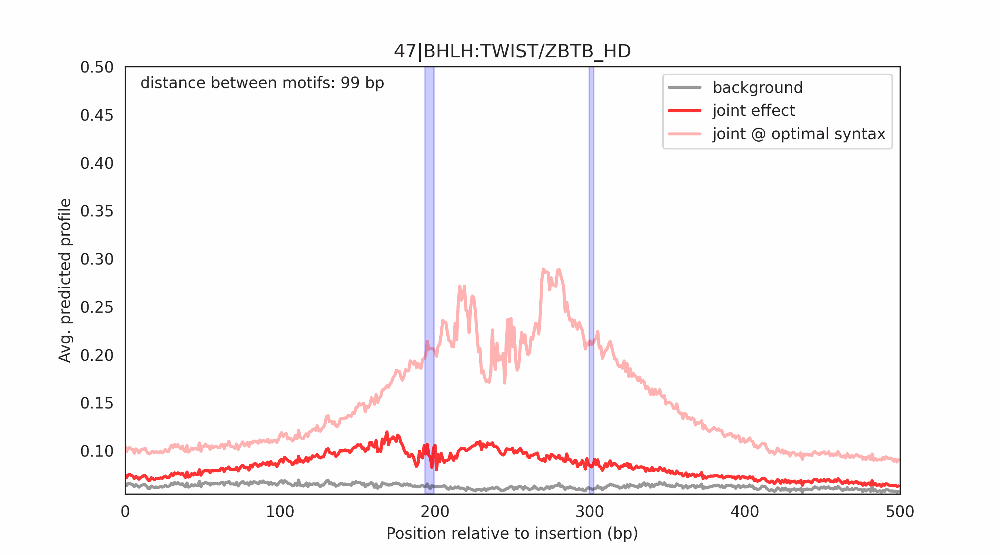

In [ ]:
# ensure the file is read with the correct encoding
with open(os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), 'rb') as f:
	gif_data = f.read()

# encode the GIF data in base64
gif_base64 = base64.b64encode(gif_data).decode('utf-8')

# display the GIF as HTML
display(HTML(f'<img src="data:image/gif;base64,{gif_base64}" />'))

## 430|RUNX_TCF7L

In [12]:
motif = "430|RUNX_TCF7L/LEF"
motif_safe = motif.replace("/", ".")
pkl_path = os.path.join(ism_path, f"{motif_safe}/predictions.pkl")
solo_pkl_path = os.path.join(ism_path, f"{motif_safe}/solo_predictions.pkl")
config_path = os.path.join(ism_path, f"{motif_safe}/config.tsv")
results_path = os.path.join(ism_path, f"{motif_safe}/results.tsv")

In [21]:
# load pkl
with open(pkl_path, 'rb') as f:
	spacing_preds = pickle.load(f)

spacing_preds.keys()

dict_keys(['A,B HT', 'B,A HT', 'HH', 'TT'])

In [22]:
animate_accessibility_profile_from_pkl(
	motif, config_path, results_path, spacing_preds,
	os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), reverse = True)

torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
0.6650242805480957
0.12035832554101944
Effective Frame: 0, Spacing: 99
Effective Frame: 1, Spacing: 98
Effective Frame: 2, Spacing: 97
Effective Frame: 3, Spacing: 96
Effective Frame: 4, Spacing: 95
Effective Frame: 5, Spacing: 94
Effective Frame: 6, Spacing: 93
Effective Frame: 7, Spacing: 92
Effective Frame: 8, Spacing: 91
Effective Frame: 9, Spacing: 90
Effective Frame: 10, Spacing: 89
Effective Frame: 11, Spacing: 88
Effective Frame: 12, Spacing: 87
Effective Frame: 13, Spacing: 86
Effective Frame: 14, Spacing: 85
Effective Frame: 15, Spacing: 84
Effective Frame: 16, Spacing: 83
Effective Frame: 17, Spacing: 82
Effective Frame: 18, Spacing: 81
Effective Frame: 19, Spacing: 80
Effective Frame: 20, Spacing: 79
Effective Frame: 21, Spacing: 78
Effective Frame: 22, Spacing: 77
Effective Frame: 23, Spacing: 76
Effective Frame: 24, Spacing: 75
Effective Frame: 25, Spacing: 74
Effective Frame: 26, Spacing: 73

![](figures/20250325/430|RUNX_TCF7L.LEF_accessibility_animation.gif)


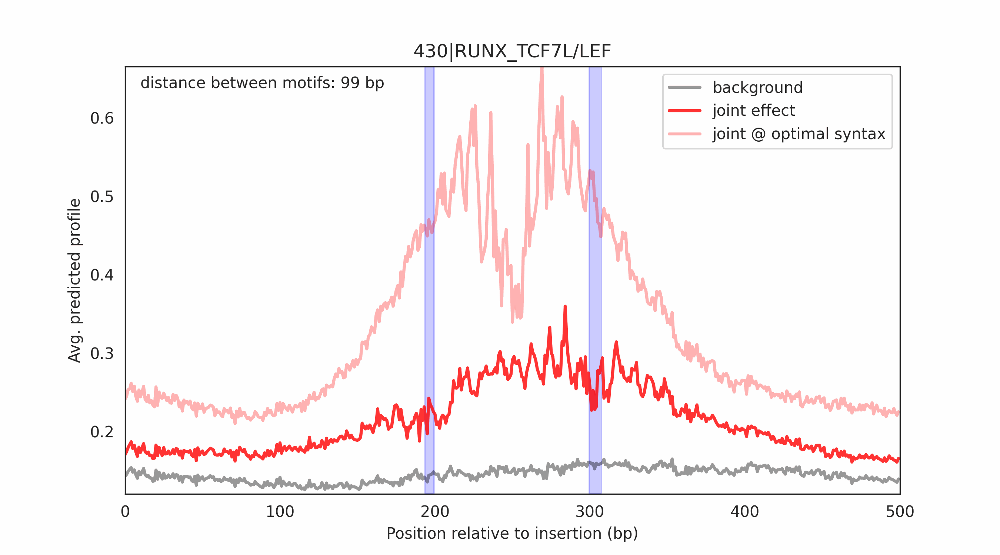

In [ ]:
# ensure the file is read with the correct encoding
with open(os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), 'rb') as f:
	gif_data = f.read()

# encode the GIF data in base64
gif_base64 = base64.b64encode(gif_data).decode('utf-8')

# display the GIF as HTML
display(HTML(f'<img src="data:image/gif;base64,{gif_base64}" />'))

## 74|BHLH_HD

In [14]:
motif = "74|BHLH_HD:PBX1/PDX1"
motif_safe = motif.replace("/", ".")
pkl_path = os.path.join(ism_path, f"{motif_safe}/predictions.pkl")
config_path = os.path.join(ism_path, f"{motif_safe}/config.tsv")
results_path = os.path.join(ism_path, f"{motif_safe}/results.tsv")

In [24]:
# load pkl
with open(pkl_path, 'rb') as f:
	spacing_preds = pickle.load(f)

spacing_preds.keys()

dict_keys(['A,B HT', 'B,A HT', 'HH', 'TT'])

In [25]:
animate_accessibility_profile_from_pkl(
	motif, config_path, results_path, spacing_preds, os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), reverse = True)

torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
0.5029655694961548
0.07764343917369843
Effective Frame: 0, Spacing: 99
Effective Frame: 1, Spacing: 98
Effective Frame: 2, Spacing: 97
Effective Frame: 3, Spacing: 96
Effective Frame: 4, Spacing: 95
Effective Frame: 5, Spacing: 94
Effective Frame: 6, Spacing: 93
Effective Frame: 7, Spacing: 92
Effective Frame: 8, Spacing: 91
Effective Frame: 9, Spacing: 90
Effective Frame: 10, Spacing: 89
Effective Frame: 11, Spacing: 88
Effective Frame: 12, Spacing: 87
Effective Frame: 13, Spacing: 86
Effective Frame: 14, Spacing: 85
Effective Frame: 15, Spacing: 84
Effective Frame: 16, Spacing: 83
Effective Frame: 17, Spacing: 82
Effective Frame: 18, Spacing: 81
Effective Frame: 19, Spacing: 80
Effective Frame: 20, Spacing: 79
Effective Frame: 21, Spacing: 78
Effective Frame: 22, Spacing: 77
Effective Frame: 23, Spacing: 76
Effective Frame: 24, Spacing: 75
Effective Frame: 25, Spacing: 74
Effective Frame: 26, Spacing: 73

![](figures/20250325/74|BHLH_HD:PBX1.PDX1_accessibility_animation.gif)



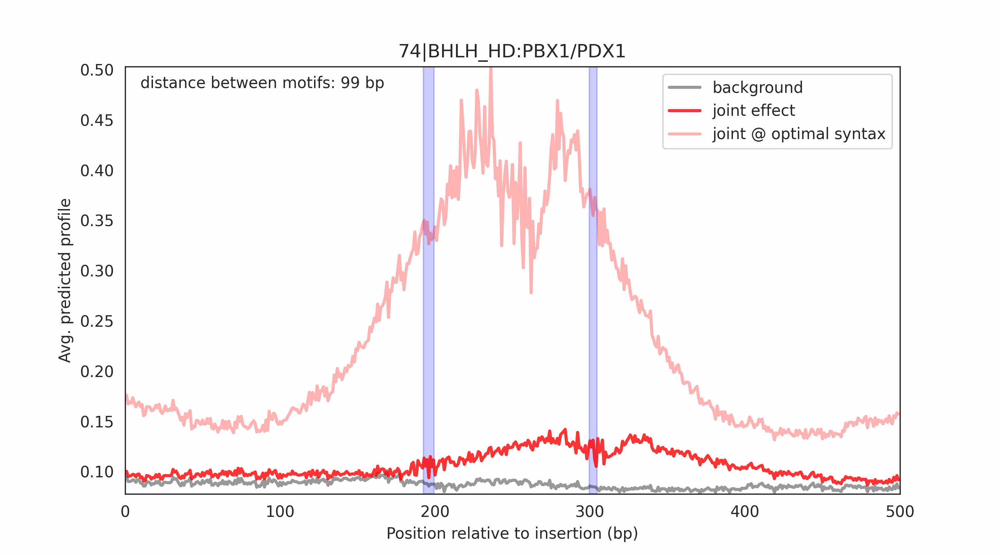

In [15]:
# ensure the file is read with the correct encoding
with open(os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), 'rb') as f:
	gif_data = f.read()

# encode the GIF data in base64
gif_base64 = base64.b64encode(gif_data).decode('utf-8')

# display the GIF as HTML
display(HTML(f'<img src="data:image/gif;base64,{gif_base64}" />'))

## 423|RFX_SOX

In [16]:
motif = "423|RFX_SOX"
motif_safe = motif.replace("/", ".")
pkl_path = os.path.join(ism_path, f"{motif_safe}/predictions.pkl")
config_path = os.path.join(ism_path, f"{motif_safe}/config.tsv")
results_path = os.path.join(ism_path, f"{motif_safe}/results.tsv")

In [27]:
# load pkl
with open(pkl_path, 'rb') as f:
	spacing_preds = pickle.load(f)

spacing_preds.keys()

dict_keys(['A,B HT', 'B,A HT', 'HH', 'TT'])

In [28]:
animate_accessibility_profile_from_pkl(
	motif, config_path, results_path, spacing_preds, os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), reverse = True)

torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
torch.Size([201, 1, 1000])
0.5
0.02881980873644352
Effective Frame: 0, Spacing: 99
Effective Frame: 1, Spacing: 98
Effective Frame: 2, Spacing: 97
Effective Frame: 3, Spacing: 96
Effective Frame: 4, Spacing: 95
Effective Frame: 5, Spacing: 94
Effective Frame: 6, Spacing: 93
Effective Frame: 7, Spacing: 92
Effective Frame: 8, Spacing: 91
Effective Frame: 9, Spacing: 90
Effective Frame: 10, Spacing: 89
Effective Frame: 11, Spacing: 88
Effective Frame: 12, Spacing: 87
Effective Frame: 13, Spacing: 86
Effective Frame: 14, Spacing: 85
Effective Frame: 15, Spacing: 84
Effective Frame: 16, Spacing: 83
Effective Frame: 17, Spacing: 82
Effective Frame: 18, Spacing: 81
Effective Frame: 19, Spacing: 80
Effective Frame: 20, Spacing: 79
Effective Frame: 21, Spacing: 78
Effective Frame: 22, Spacing: 77
Effective Frame: 23, Spacing: 76
Effective Frame: 24, Spacing: 75
Effective Frame: 25, Spacing: 74
Effective Frame: 26, Spacing: 73
Effective Fram

Effective Frame: 38, Spacing: 61
Effective Frame: 39, Spacing: 60
Effective Frame: 40, Spacing: 59
Effective Frame: 41, Spacing: 58
Effective Frame: 42, Spacing: 57
Effective Frame: 43, Spacing: 56
Effective Frame: 44, Spacing: 55
Effective Frame: 45, Spacing: 54
Effective Frame: 46, Spacing: 53
Effective Frame: 47, Spacing: 52
Effective Frame: 48, Spacing: 51
Effective Frame: 49, Spacing: 50
Effective Frame: 50, Spacing: 49
Effective Frame: 51, Spacing: 48
Effective Frame: 52, Spacing: 47
Effective Frame: 53, Spacing: 46
Effective Frame: 54, Spacing: 45
Effective Frame: 55, Spacing: 44
Effective Frame: 56, Spacing: 43
Effective Frame: 57, Spacing: 42
Effective Frame: 58, Spacing: 41
Effective Frame: 59, Spacing: 40
Effective Frame: 60, Spacing: 39
Effective Frame: 61, Spacing: 38
Effective Frame: 62, Spacing: 37
Effective Frame: 63, Spacing: 36
Effective Frame: 64, Spacing: 35
Effective Frame: 65, Spacing: 34
Effective Frame: 66, Spacing: 33
Effective Frame: 67, Spacing: 32
Effective 

![](figures/20250325/423|RFX_SOX_accessibility_animation.gif)


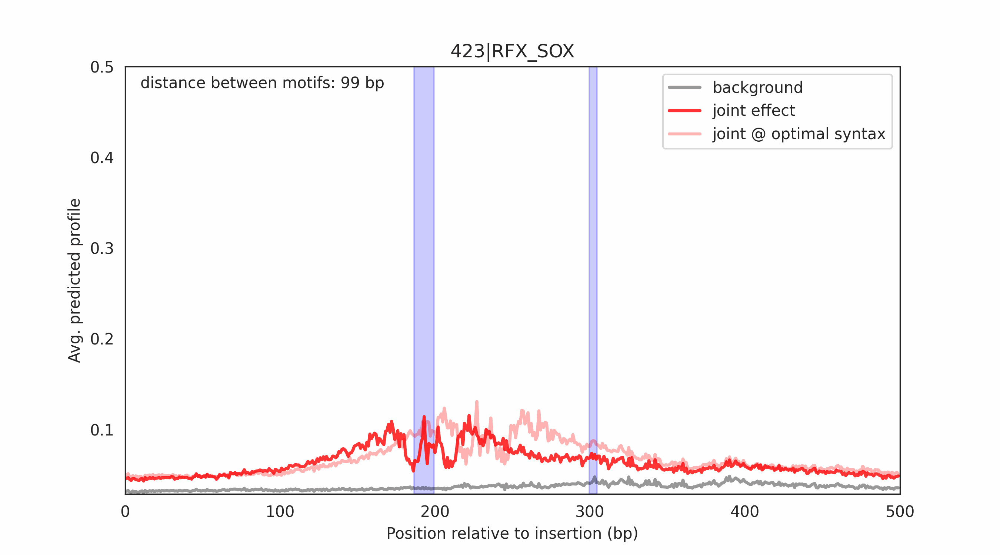

In [17]:
# ensure the file is read with the correct encoding
with open(os.path.join(fig_out, f"{motif_safe}_accessibility_animation.gif"), 'rb') as f:
	gif_data = f.read()

# encode the GIF data in base64
gif_base64 = base64.b64encode(gif_data).decode('utf-8')

# display the GIF as HTML
display(HTML(f'<img src="data:image/gif;base64,{gif_base64}" />'))